# Transformer to generate music

## Imports
import all the packages used in this notebook.

In [1]:
%%capture
!sudo apt install -y fluidsynth
!pip install --upgrade pyfluidsynth
!pip install pretty_midi
!pip3 install miditok
!pip3 install split-folders
!pip3 install tqdm
!pip install -q -U keras-tuner

In [2]:
from google.colab import drive
from IPython import display
import pretty_midi
import fluidsynth
from miditok import TSD
from miditoolkit import MidiFile
from pathlib import Path
import tensorflow_datasets as tfds
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import json
import pathlib
import glob
import os
import keras_tuner as kt
import datetime

## Download dataset

The datasets used in this notebook are: __[Jazz Music](https://jazzomat.hfm-weimar.de/dbformat/dbcontent.html)__ and Piano Music.

In [3]:
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [4]:
%%capture
!rm -r datasets
!cp /content/drive/MyDrive/__Baldi_Cecchetti/datasets/dataset_jazz.zip /content
!cp /content/drive/MyDrive/__Baldi_Cecchetti/datasets/dataset_piano.zip /content
!cp -r /content/drive/MyDrive/__Baldi_Cecchetti/models/Transformer/saved_model /content
!mkdir datasets
!unzip /content/dataset_jazz.zip -d datasets
!unzip /content/dataset_piano.zip -d datasets

## Utils

### Play MIDI files

We install a special package in order to play MIDI files.

In [5]:
_SAMPLING_RATE = 32000

def display_audio(midi_path: str, seconds=30):
    pm = pretty_midi.PrettyMIDI(midi_path)
    waveform = pm.fluidsynth(fs=_SAMPLING_RATE)
    # Take a sample of the generated waveform to mitigate kernel resets
    waveform_short = waveform[:seconds*_SAMPLING_RATE]
    return display.Audio(waveform_short, rate=_SAMPLING_RATE)

### Plot loss

In [6]:
def plot_loss(history, title):
    loss = history.history["loss"]
    val_loss = history.history["val_loss"]
    print('val_loss', val_loss)
    print('loss', loss)
    plt.figure()
    plt.plot(val_loss,'o-b', label='validation loss')
    plt.title('val_loss')
    plt.plot(loss,'o-r', label='train loss')
    plt.title(title)
    plt.legend()
    plt.show()

## Generate the music

First we define a function which transforms the distribution of probability in the predicted token by taking in consideration the temperature.

In [7]:
def sample_next(predictions, temperature=0.1):
    predictions = np.asarray(predictions).astype("float64")
    predictions = np.log(predictions) / temperature
    exp_preds = np.exp(predictions)
    predictions = exp_preds / np.sum(exp_preds)
    probas = np.random.multinomial(1, predictions, 1)
    return np.argmax(probas)

Then, we define a function that we will use to generate music with our models.

In [8]:
def generate_music(model, test_dataset, tokenizer, temperature, path=None, max_length=100):
    # check parameters
    if path is None:
        path = "output.mid"
    if max_length < 0:
        max_length = 100

    print(f"\nGenerating MIDI with temperature of {temperature}...")
    # buffer for the generated tokens
    generated_tokens = []

    current_seq = None
    for seq, labels in test_dataset.take(1):
        current_seq = seq[0].numpy()

    # generate a certain number of tokens
    for i in tqdm(range(max_length)):
        prediction = model.predict(
            current_seq.reshape((1, SEQUENCE_LENGTH)), 
            verbose=0
        )
        # save the new token
        next_token = sample_next(prediction[0, -1, :], temperature)
        generated_tokens.append(next_token.item())
        current_seq = current_seq[1:]
        current_seq = np.append(current_seq, next_token)


    midi = tokenizer.tokens_to_midi([generated_tokens])
    midi.dump(path)
    print(f"MIDI generated: {path}")

## Tokenization

In order to transform our MIDI files in token we use the MidiTok library __[MidiTok](https://github.com/Natooz/MidiTok)__, which allows us to tokenize the whole dataset by applying pre-processing and data augmentation.

### Load the tokenizer from configuration

MidiTok allows us to tokenize the whole dataset and stores it on JSON files. Now we can choose on of the tokenizer that we have already prepared.

In [9]:
tokenizer_jazz = TSD(params=f"datasets/content/dataset_jazz/train/tokens_bpe/config.txt")

In [10]:
tokenizer_piano = TSD(params=f"datasets/content/dataset_piano/train/tokens_bpe/config.txt")

In [11]:
VOCAB_SIZE_JAZZ = len(tokenizer_jazz.vocab)
print(VOCAB_SIZE_JAZZ)
VOCAB_SIZE_PIANO = len(tokenizer_piano.vocab)
print(VOCAB_SIZE_PIANO)

500
500


## Dataset pre-processing


Format the music dataset for causal Transformr: in order to allow the model to predicts the next note in the sequence given the previous notes.

In [12]:
# pre-processing parameters
BATCH_SIZE = 200
SEQUENCE_LENGTH = 64
BUFFER_SIZE = 20000

'''
A sequence is coupled with the sequence shifted of one token.
'''
def split_input_target(chunk):
    input_text = chunk[:-1]
    target_text = chunk[1:]
    return input_text, target_text

'''
Extract all the tokens from a directory which contains
JSON files.
'''
def extract_tokens(dir_path):
    dir_path = pathlib.Path(dir_path)
    filenames = glob.glob(str(dir_path/'*.json*'))
    seq_of_tokens = []
    # take the sequence of tokens from MIDI files
    for filename in tqdm(filenames): 
        with open(filename) as f:
            json_file = json.load(f)
            tokens = json_file['tokens'][0]
            dataset = tf.data.Dataset.from_tensor_slices(tokens)
            sequences = dataset.batch(SEQUENCE_LENGTH+1, drop_remainder=True)
            seq_of_tokens.append(sequences)

    sequences_concatenated = seq_of_tokens[0]

    for sequences in tqdm(seq_of_tokens[1:]):
        sequences_concatenated = sequences_concatenated.concatenate(sequences)
    
    dataset = sequences_concatenated.map(split_input_target)
    return dataset
    

# our datasets
train_jazz = extract_tokens(f"datasets/content/dataset_jazz/train/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)
test_jazz = extract_tokens(f"datasets/content/dataset_jazz/test/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)
val_jazz = extract_tokens(f"datasets/content/dataset_jazz/val/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)

train_piano = extract_tokens(f"datasets/content/dataset_piano/train/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)
test_piano = extract_tokens(f"datasets/content/dataset_piano/test/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)
val_piano = extract_tokens(f"datasets/content/dataset_piano/val/tokens_bpe").batch(BATCH_SIZE, drop_remainder=True)

print("Dataset of Jazz music")
print(train_jazz, val_jazz, test_jazz)

print("Dataset of Piano music")
print(train_piano, val_piano, test_piano)

  0%|          | 0/300 [00:00<?, ?it/s]

  0%|          | 0/299 [00:00<?, ?it/s]

  0%|          | 0/86 [00:00<?, ?it/s]

  0%|          | 0/85 [00:00<?, ?it/s]

  0%|          | 0/42 [00:00<?, ?it/s]

  0%|          | 0/41 [00:00<?, ?it/s]

  0%|          | 0/542 [00:00<?, ?it/s]

  0%|          | 0/541 [00:00<?, ?it/s]

  0%|          | 0/156 [00:00<?, ?it/s]

  0%|          | 0/155 [00:00<?, ?it/s]

  0%|          | 0/77 [00:00<?, ?it/s]

  0%|          | 0/76 [00:00<?, ?it/s]

Dataset of Jazz music
<BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))> <BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))> <BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))>
Dataset of Piano music
<BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))> <BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))> <BatchDataset element_spec=(TensorSpec(shape=(200, 64), dtype=tf.int32, name=None), TensorSpec(shape=(200, 64), dtype=tf.int32, name=None))>


Check if the dataset is correctly shifted

In [13]:
for elem in train_jazz.take(1):
    print(elem)

(<tf.Tensor: shape=(200, 64), dtype=int32, numpy=
array([[247, 304, 254, ..., 261, 413, 123],
       [ 46, 118, 251, ..., 265,  61, 118],
       [ 60, 118, 255, ..., 256,  58, 118],
       ...,
       [107, 127, 479, ..., 122, 249, 189],
       [257, 426, 257, ..., 299, 251, 353],
       [340, 273, 495, ..., 315, 266, 306]], dtype=int32)>, <tf.Tensor: shape=(200, 64), dtype=int32, numpy=
array([[304, 254, 284, ..., 413, 123, 193],
       [118, 251, 336, ...,  61, 118, 297],
       [118, 255,  59, ...,  58, 118, 265],
       ...,
       [127, 479, 390, ..., 249, 189, 394],
       [426, 257, 361, ..., 251, 353, 273],
       [273, 495, 259, ..., 266, 306, 251]], dtype=int32)>)


## Model

### Positional embedding
Positional embedding in order to take in consideration the ordering of the notes.


In [14]:
'''
Custom layer used to implement the positional embedding.

:param sequence_length: number of tokens per sequence
:param input_dim: number of entry in the vocabulary
:param output_dim: size of the embedding returned
'''
class PositionalEmbedding(tf.keras.layers.Layer):

    def __init__(self, sequence_length, input_dim, output_dim, **kwargs):
        super().__init__(**kwargs)

        self.token_embeddings = tf.keras.layers.Embedding(
            input_dim=input_dim, 
            output_dim=output_dim, 
        )
        self.position_embeddings = tf.keras.layers.Embedding(
            input_dim=input_dim, 
            output_dim=output_dim,
        )

        self.sequence_length = sequence_length
        self.input_dim = input_dim
        self.output_dim = output_dim
        
    def call(self, inputs):
        length = tf.shape(inputs)[-1]
        positions = tf.range(start=0, limit=length, delta=1)
        embedded_tokens = self.token_embeddings(inputs)
        embedded_positions = self.position_embeddings(positions)
        return embedded_tokens + embedded_positions

    def compute_mask(self, inputs, mask=None):
        return tf.math.not_equal(inputs, 0)

    # method used to serialize the layer and save it
    def get_config(self):
        config = super().get_config()
        config.update({
            "output_dim": self.output_dim,
            "sequence_length": self.sequence_length,
            "input_dim": self.input_dim,
        })
        return config
    


### Decoder
Decoder layer, which is slightly more complex than the encoder.

In [15]:
'''
Class that implements the decoder layer composed by a causal attentio layer, 
a cross attention layer and by Feed Forward layer. They could be stack one over 
the other in order to increase the architecture of the transformer.
'''
class DecoderLayer(tf.keras.layers.Layer):

    def __init__(self, embed_dim, dense_dim, num_heads, **kwargs):
        super().__init__(**kwargs)
        self.embed_dim = embed_dim
        self.dense_dim = dense_dim
        self.num_heads = num_heads

        # Multi head self-attention layers
        self.attention_1 = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads, 
            key_dim=embed_dim
        )
        self.attention_2 = tf.keras.layers.MultiHeadAttention(
            num_heads=num_heads, 
            key_dim=embed_dim
        )

        # Feed Forward
        self.dense_proj = tf.keras.models.Sequential([
            tf.keras.layers.Dense(dense_dim, activation="relu"),
            tf.keras.layers.Dense(embed_dim),
        ])

        # Normalization layers
        self.layernorm_1 = tf.keras.layers.LayerNormalization()
        self.layernorm_2 = tf.keras.layers.LayerNormalization()
        self.layernorm_3 = tf.keras.layers.LayerNormalization()

        self.supports_masking = True

    # method used to serialize the layer and save it
    def get_config(self):
        config = super().get_config() 
        config.update({
            "embed_dim": self.embed_dim,
            "num_heads": self.num_heads,
            "dense_dim": self.dense_dim,
        })
        return config

    # method used to compute the causal attention mask in order to
    # to mask to a note the notes that will come after
    def get_causal_attention_mask(self, inputs):
        input_shape = tf.shape(inputs)
        batch_size, sequence_length = input_shape[0], input_shape[1] 
        i = tf.range(sequence_length)[:, tf.newaxis]
        j = tf.range(sequence_length)
        mask = tf.cast(i >= j, dtype="int32")
        mask = tf.reshape(mask, (1, input_shape[1], input_shape[1])) 
        mult = tf.concat([
            tf.expand_dims(batch_size, -1),
            tf.constant([1, 1], dtype=tf.int32)
            ], 
            axis=0
        )
        return tf.tile(mask, mult)

    def call(self, inputs, encoder_outputs, mask=None): 
        causal_mask = self.get_causal_attention_mask(inputs)
        if mask is not None: 
            padding_mask = tf.cast(
                mask[:, tf.newaxis, :], 
                dtype="int32"
            )
            padding_mask = tf.minimum(padding_mask, causal_mask)
        
        attention_output_1 = self.attention_1(
            query=inputs,
            value=inputs,
            key=inputs,
            attention_mask=causal_mask
        )

        attention_output_1 = self.layernorm_1(inputs + attention_output_1)

        attention_output_2 = self.attention_2(
            query=attention_output_1,
            value=encoder_outputs,
            key=encoder_outputs,
            attention_mask=padding_mask,
        )

        attention_output_2 = self.layernorm_2(
            attention_output_1 + attention_output_2
        )

        proj_output = self.dense_proj(attention_output_2)
        
        return self.layernorm_3(attention_output_2 + proj_output)

## Transformer

In [16]:
def build_model(embed_dim, latent_dim, num_heads, num_layers, vocab_size):
    inputs = tf.keras.Input(shape=(None,), dtype="int32")

    x = PositionalEmbedding(SEQUENCE_LENGTH, vocab_size, embed_dim)(inputs)

    for _ in range(num_layers):
        x = DecoderLayer(embed_dim, latent_dim, num_heads)(x, x)

    output = tf.keras.layers.Dense(vocab_size, activation="softmax")(x)

    decoder = tf.keras.models.Model(inputs, output) 

    return decoder

# Monophonic music generation (Jazz)

### Underfit configuration
We configure the transformer with a low number of parameters in order to underfit the model. 

In [ ]:
# overfit configuration
embed_dim = 64
latent_dim = 32
num_heads = 1
num_layers = 1

decoder_underfit = build_model(
    embed_dim=embed_dim, 
    latent_dim=latent_dim, 
    num_heads=num_heads, 
    num_layers=num_layers,
    vocab_size=VOCAB_SIZE_JAZZ
)

decoder_underfit.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)
)

In [ ]:
decoder_underfit.summary()

Model: "model_9"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_9 (Positi  (None, None, 64)    64000       ['input_10[0][0]']               
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_11 (DecoderLayer  (None, None, 64)    37856       ['positional_embedding_9[0][0]', 
 )                                                                'positional_embedding_9[0][0]'] 
                                                                                            

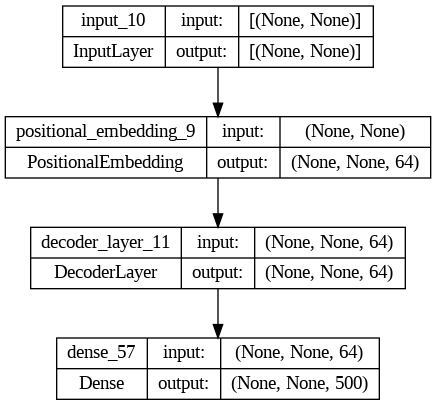

In [ ]:
tf.keras.utils.plot_model(decoder_underfit, show_shapes=True)

In [ ]:
epochs = 100

history = decoder_underfit.fit(
    train_jazz,
    epochs=epochs,
    validation_data=val_jazz,
    use_multiprocessing=True,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor="val_loss",
            patience=10,
            verbose=0
        ),
    ]
)

Epoch 1/100
22/22 [==============================] - 8s 133ms/step - loss: 5.9536 - val_loss: 5.6475
Epoch 2/100
22/22 [==============================] - 1s 50ms/step - loss: 5.3711 - val_loss: 5.1121
Epoch 3/100
22/22 [==============================] - 1s 51ms/step - loss: 4.7906 - val_loss: 4.6452
Epoch 4/100
22/22 [==============================] - 3s 157ms/step - loss: 4.4763 - val_loss: 4.4605
Epoch 5/100
22/22 [==============================] - 2s 67ms/step - loss: 4.3334 - val_loss: 4.3660
Epoch 6/100
22/22 [==============================] - 2s 72ms/step - loss: 4.2501 - val_loss: 4.3107
Epoch 7/100
22/22 [==============================] - 1s 55ms/step - loss: 4.1980 - val_loss: 4.2776
Epoch 8/100
22/22 [==============================] - 1s 48ms/step - loss: 4.1602 - val_loss: 4.2505
Epoch 9/100
22/22 [==============================] - 1s 47ms/step - loss: 4.1217 - val_loss: 4.2115
Epoch 10/100
22/22 [==============================] - 1s 50ms/step - loss: 4.0694 - val_loss: 4.15

Plot the loss of the training against the validation loss.

val_loss [5.647498607635498, 5.112053871154785, 4.645219802856445, 4.4604949951171875, 4.366032123565674, 4.31069803237915, 4.277586936950684, 4.250467300415039, 4.211533069610596, 4.1552734375, 4.092861175537109, 4.0391645431518555, 3.998943567276001, 3.9627583026885986, 3.9190735816955566, 3.8791940212249756, 3.8513073921203613, 3.8334171772003174, 3.819626808166504, 3.811136484146118, 3.8042776584625244, 3.798520565032959, 3.7929847240448, 3.788638114929199, 3.784825325012207, 3.7818236351013184, 3.777571678161621, 3.7741007804870605, 3.7717251777648926, 3.7692432403564453, 3.767258405685425, 3.766148328781128, 3.76314377784729, 3.7616398334503174, 3.7612264156341553, 3.7598371505737305, 3.759901523590088, 3.759514093399048, 3.759636163711548, 3.7572567462921143, 3.7560839653015137, 3.7500228881835938, 3.750044822692871, 3.7477986812591553, 3.74674916267395, 3.7453970909118652, 3.744853973388672, 3.74381422996521, 3.7435405254364014, 3.742788076400757, 3.742157459259033, 3.741117238

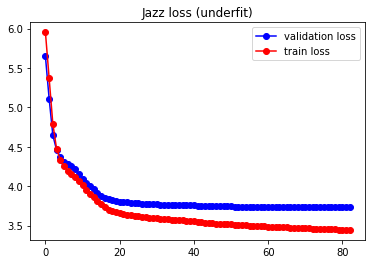

In [ ]:
# plot the loss
plot_loss(history, title="Jazz loss (underfit)")

In [ ]:
# evaluate
losses = decoder_underfit.evaluate(test_jazz, return_dict=True)
losses

6/6 [==============================] - 0s 32ms/step - loss: 3.6991


{'loss': 3.699092149734497}

### Overfit configuration
We configure the transformer with an high number of parameters in order to overfit the model. 

In [ ]:
# overfit configuration
embed_dim = 512
latent_dim = 512
num_heads = 2
num_layers = 2

decoder_overfit = build_model(
    embed_dim=embed_dim, 
    latent_dim=latent_dim, 
    num_heads=num_heads, 
    num_layers=num_layers,
    vocab_size=VOCAB_SIZE_JAZZ
)

decoder_overfit.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)
)

In [ ]:
decoder_overfit.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_2 (Positi  (None, None, 512)   512000      ['input_3[0][0]']                
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_9 (DecoderLayer)  (None, None, 512)   4729856     ['positional_embedding_2[0][0]', 
                                                                  'positional_embedding_2[0][0]'] 
                                                                                            

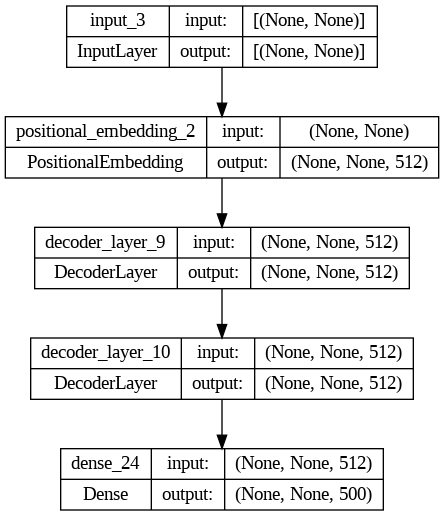

In [ ]:
tf.keras.utils.plot_model(decoder_overfit, show_shapes=True)

In [ ]:
epochs = 100

history = decoder_overfit.fit(
    train_jazz,
    epochs=epochs,
    validation_data=val_jazz,
    use_multiprocessing=True,
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor="val_loss",
            patience=10,
            verbose=0
        ),
    ]
)

Epoch 1/100
22/22 [==============================] - 16s 326ms/step - loss: 5.5686 - val_loss: 4.8005
Epoch 2/100
22/22 [==============================] - 6s 281ms/step - loss: 4.3390 - val_loss: 4.2599
Epoch 3/100
22/22 [==============================] - 6s 296ms/step - loss: 4.0230 - val_loss: 3.9976
Epoch 4/100
22/22 [==============================] - 7s 298ms/step - loss: 3.8302 - val_loss: 3.9004
Epoch 5/100
22/22 [==============================] - 7s 305ms/step - loss: 3.7275 - val_loss: 3.8542
Epoch 6/100
22/22 [==============================] - 6s 287ms/step - loss: 3.6408 - val_loss: 3.8252
Epoch 7/100
22/22 [==============================] - 7s 300ms/step - loss: 3.6053 - val_loss: 3.8206
Epoch 8/100
22/22 [==============================] - 7s 296ms/step - loss: 3.5366 - val_loss: 3.8271
Epoch 9/100
22/22 [==============================] - 6s 282ms/step - loss: 3.4725 - val_loss: 3.8263
Epoch 10/100
22/22 [==============================] - 7s 299ms/step - loss: 3.4251 - val_l

val_loss [4.8004584312438965, 4.259869575500488, 3.9975521564483643, 3.9004130363464355, 3.8541862964630127, 3.825155019760132, 3.8205602169036865, 3.8270654678344727, 3.8263187408447266, 3.839791774749756, 3.8628275394439697, 3.864088535308838, 3.9131815433502197, 3.931313991546631, 3.956942558288574, 3.9917521476745605, 4.004063129425049]
loss [5.568593978881836, 4.339044094085693, 4.022969722747803, 3.83018159866333, 3.727489709854126, 3.6408259868621826, 3.605311870574951, 3.536642074584961, 3.4725167751312256, 3.425117015838623, 3.400226354598999, 3.328582763671875, 3.267011880874634, 3.213564395904541, 3.166942834854126, 3.1107051372528076, 3.054124116897583]


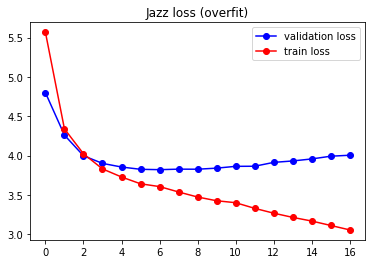

In [ ]:
# plot the loss
plot_loss(history, title="Jazz loss (overfit)")

In [ ]:
# evaluate
losses = decoder_overfit.evaluate(test_jazz, return_dict=True)
losses

6/6 [==============================] - 1s 102ms/step - loss: 3.9533


{'loss': 3.9532909393310547}

### Callbacks
We define a custom callback which will generate samples of music, with different values of temperature, while training the model in order to monitor the its generation capabilities.

In [21]:
'''
Callback used to generate music during the training
'''
class MusicGenerator(tf.keras.callbacks.Callback):

    def __init__(self,
                 generate_len,
                 test_dataset,
                 tokenizer,
                 temperatures=(1.,),
                 print_freq=1):
        self.generate_len = generate_len
        self.test_dataset = test_dataset
        self.tokenizer = tokenizer
        self.temperatures = temperatures
        self.print_freq = print_freq

    def on_epoch_end(self, epoch, logs=None):
        if (epoch+1) % self.print_freq != 0:
            return
        
        if not os.path.exists('generated_midis'):
            os.makedirs('generated_midis')
        
        for temperature in self.temperatures:
            generate_music(
                self.model,
                self.test_dataset,
                self.tokenizer,
                temperature, 
                max_length=self.generate_len, 
                path=f"generated_midis/output_{epoch+1}_{int(temperature*10)}.mid"
            )

In [ ]:
# init callbacks
music_gen_callback = MusicGenerator(
    generate_len=200,
    test_dataset=test_jazz,
    tokenizer=tokenizer_jazz,
    temperatures=(0.2, 0.5, 0.7, 1., 1.5),
    print_freq=20
)

callbacks = [
    music_gen_callback,
    tf.keras.callbacks.EarlyStopping(
        monitor="val_loss",
        patience=10,
        verbose=0
    ),
]

### Train the model
Now we train the model in order to reach good level of generalization.

In [ ]:
# overfit configuration
embed_dim = 64
latent_dim = 128
num_heads = 5
num_layers = 1

decoder = build_model(
    embed_dim=embed_dim, 
    latent_dim=latent_dim, 
    num_heads=num_heads, 
    num_layers=num_layers,
    vocab_size=VOCAB_SIZE_JAZZ
)

decoder.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001)
)

In [ ]:
decoder.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding (Position  (None, None, 64)    64000       ['input_1[0][0]']                
 alEmbedding)                                                                                     
                                                                                                  
 decoder_layer (DecoderLayer)   (None, None, 64)     182848      ['positional_embedding[0][0]',   
                                                                  'positional_embedding[0][0]']   
                                                                                              

In [ ]:
epochs = 100

history = decoder.fit(
    train_jazz,
    epochs=epochs,
    validation_data=val_jazz,
    use_multiprocessing=True,
    callbacks=callbacks
)

Epoch 1/100
22/22 [==============================] - 14s 183ms/step - loss: 5.9094 - val_loss: 5.6445
Epoch 2/100
22/22 [==============================] - 1s 51ms/step - loss: 5.4079 - val_loss: 5.1559
Epoch 3/100
22/22 [==============================] - 1s 51ms/step - loss: 4.8188 - val_loss: 4.6534
Epoch 4/100
22/22 [==============================] - 1s 51ms/step - loss: 4.4634 - val_loss: 4.4466
Epoch 5/100
22/22 [==============================] - 1s 52ms/step - loss: 4.3071 - val_loss: 4.3534
Epoch 6/100
22/22 [==============================] - 1s 52ms/step - loss: 4.2308 - val_loss: 4.3060
Epoch 7/100
22/22 [==============================] - 2s 94ms/step - loss: 4.1855 - val_loss: 4.2766
Epoch 8/100
22/22 [==============================] - 2s 84ms/step - loss: 4.1485 - val_loss: 4.2434
Epoch 9/100
22/22 [==============================] - 1s 52ms/step - loss: 4.1057 - val_loss: 4.1888
Epoch 10/100
22/22 [==============================] - 1s 52ms/step - loss: 4.0369 - val_loss: 4.10

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_20_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_20_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_20_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_20_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_20_15.mid
22/22 [==============================] - 67s 3s/step - loss: 3.6227 - val_loss: 3.7859
Epoch 21/100
22/22 [==============================] - 1s 48ms/step - loss: 3.6124 - val_loss: 3.7799
Epoch 22/100
22/22 [==============================] - 1s 52ms/step - loss: 3.6029 - val_loss: 3.7757
Epoch 23/100
22/22 [==============================] - 1s 49ms/step - loss: 3.5948 - val_loss: 3.7714
Epoch 24/100
22/22 [==============================] - 1s 51ms/step - loss: 3.5873 - val_loss: 3.7687
Epoch 25/100
22/22 [==============================] - 1s 54ms/step - loss: 3.5807 - val_loss: 3.7655
Epoch 26/100
22/22 [==============================] - 2s 91ms/step - loss: 3.5746 - val_loss: 3.7636
Epoch 27/100
22/22 [==============================] - 2s 68ms/step - loss: 3.5689 - val_loss: 3.7605
Epoch 28/100
22/22 [==============================] - 1s 51ms/step - loss: 3.5634 - val_loss: 3.7589
Epoch 29/100
22/22 [==============================] - 1s

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_40_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_40_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_40_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_40_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_40_15.mid
22/22 [==============================] - 62s 3s/step - loss: 3.5008 - val_loss: 3.7397
Epoch 41/100
22/22 [==============================] - 1s 48ms/step - loss: 3.4963 - val_loss: 3.7389
Epoch 42/100
22/22 [==============================] - 1s 50ms/step - loss: 3.4914 - val_loss: 3.7392
Epoch 43/100
22/22 [==============================] - 1s 52ms/step - loss: 3.4868 - val_loss: 3.7382
Epoch 44/100
22/22 [==============================] - 2s 89ms/step - loss: 3.4821 - val_loss: 3.7375
Epoch 45/100
22/22 [==============================] - 2s 69ms/step - loss: 3.4777 - val_loss: 3.7362
Epoch 46/100
22/22 [==============================] - 1s 48ms/step - loss: 3.4730 - val_loss: 3.7362
Epoch 47/100
22/22 [==============================] - 1s 48ms/step - loss: 3.4685 - val_loss: 3.7353
Epoch 48/100
22/22 [==============================] - 1s 50ms/step - loss: 3.4642 - val_loss: 3.7344
Epoch 49/100
22/22 [==============================] - 1s

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_60_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_60_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_60_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_60_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_60_15.mid
22/22 [==============================] - 63s 3s/step - loss: 3.4163 - val_loss: 3.7311
Epoch 61/100
22/22 [==============================] - 1s 49ms/step - loss: 3.4127 - val_loss: 3.7314
Epoch 62/100
22/22 [==============================] - 1s 52ms/step - loss: 3.4094 - val_loss: 3.7310
Epoch 63/100
22/22 [==============================] - 1s 49ms/step - loss: 3.4061 - val_loss: 3.7322
Epoch 64/100
22/22 [==============================] - 1s 50ms/step - loss: 3.4031 - val_loss: 3.7316


Plot the loss of the training against the validation loss.

val_loss [5.644460201263428, 5.155923843383789, 4.65339469909668, 4.446613788604736, 4.353430271148682, 4.306001663208008, 4.276601791381836, 4.243391990661621, 4.188754558563232, 4.108761310577393, 4.044374942779541, 4.00595235824585, 3.970489501953125, 3.910731554031372, 3.8584790229797363, 3.829833984375, 3.810720205307007, 3.8001840114593506, 3.791496515274048, 3.785865068435669, 3.7798969745635986, 3.7756526470184326, 3.7713980674743652, 3.768739938735962, 3.765456438064575, 3.763566493988037, 3.760479688644409, 3.7589216232299805, 3.755162239074707, 3.7560782432556152, 3.755295515060425, 3.750685691833496, 3.746818780899048, 3.7468159198760986, 3.745457410812378, 3.742892265319824, 3.742112636566162, 3.741727352142334, 3.740402936935425, 3.7396504878997803, 3.7389025688171387, 3.7391698360443115, 3.738154411315918, 3.737539768218994, 3.7361979484558105, 3.736187219619751, 3.735305070877075, 3.734402656555176, 3.7324626445770264, 3.730137586593628, 3.7290990352630615, 3.7294027805

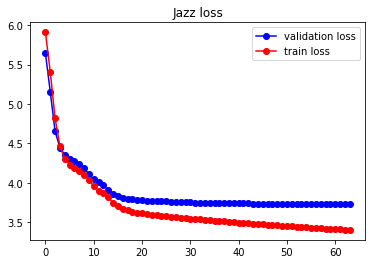

In [ ]:
# plot the loss
plot_loss(history, title="Jazz loss")

Save the model

In [ ]:
decoder.save(f"saved_model/decoder_jazz.h5")

In [ ]:
!cp -R -v saved_model/decoder_jazz.h5 '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer'

'saved_model' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model'
'saved_model/decoder_jazz' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz'
'saved_model/decoder_jazz/variables' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz/variables'
'saved_model/decoder_jazz/variables/variables.index' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz/variables/variables.index'
'saved_model/decoder_jazz/variables/variables.data-00000-of-00001' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz/variables/variables.data-00000-of-00001'
'saved_model/decoder_jazz/assets' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz/assets'
'saved_model/decoder_jazz/keras_metadata.pb' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_jazz/keras_metadata.pb

load the model

In [ ]:
# we need to specify the custom layers
loaded_decoder = tf.keras.models.load_model(
    "saved_model/decoder_jazz.h5",
    custom_objects={
        "PositionalEmbedding": PositionalEmbedding,
        "DecoderLayer": DecoderLayer,
        }
)

In [ ]:
loaded_decoder.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding (Position  (None, None, 64)    64000       ['input_1[0][0]']                
 alEmbedding)                                                                                     
                                                                                                  
 decoder_layer (DecoderLayer)   (None, None, 64)     182848      ['positional_embedding[0][0]',   
                                                                  'positional_embedding[0][0]']   
                                                                                              

## Evaluation

In [ ]:
# evaluate
losses = loaded_decoder.evaluate(test_jazz, return_dict=True)
losses

6/6 [==============================] - 1s 67ms/step - loss: 3.6829


{'loss': 3.6829423904418945}

## Hypertuning
We use the hypertuning to try different configurations in order to find the best one (lower loss).

In [ ]:
def model_builder(hp):

    inputs = tf.keras.Input(shape=(None,), dtype="int32")


    hp_embed_dim = hp.Choice(
        'embedding_dimension', 
        values=[32, 64, 128, 256]
    )

    hp_dff_dim = hp.Choice(
        'dff_dimension', 
        values=[32, 64, 128, 256]
    )

    hp_num_attention_heads = hp.Int(
        'num_attention_heads', 
        min_value=1,
        max_value=6,
        step=1
    )

    hp_decoder_layers = hp.Int(
        'num_layers', 
        min_value=1,
        max_value=4,
        step=1
    )

    hp_learning_rate = hp.Choice('learning_rate', values=[1e-2, 1e-3])
    
    x = PositionalEmbedding(SEQUENCE_LENGTH, VOCAB_SIZE_JAZZ, hp_embed_dim)(inputs)

    for _ in range(hp_decoder_layers):
        x = DecoderLayer(hp_embed_dim, hp_dff_dim, hp_num_attention_heads)(x, x)

    output = tf.keras.layers.Dense(VOCAB_SIZE_JAZZ, activation="softmax")(x)

    decoder = tf.keras.models.Model(inputs, output) 

    decoder.compile(
        loss="sparse_categorical_crossentropy",
        optimizer=tf.keras.optimizers.Adam(learning_rate=hp_learning_rate)
    )

    return decoder

In [ ]:
log_dir = "/logs/" + datetime.datetime.now().strftime("%m%d-%H%M")

tuner = kt.Hyperband(model_builder,
                     objective='val_loss',
                     overwrite=True,
                     max_epochs=100,
                     factor=3,
                     directory=log_dir,
                     project_name='Decoder_Tuner')

In [ ]:
tuner.search(
    train_jazz, 
    epochs=100, 
    validation_data=val_jazz, 
    callbacks=[
        tf.keras.callbacks.EarlyStopping(
            monitor='val_loss',
            patience=5,
            verbose=0
        )
    ])

best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]

Trial 254 Complete [00h 01m 30s]
val_loss: 3.7323482036590576

Best val_loss So Far: 3.6983706951141357
Total elapsed time: 01h 43m 38s


We save the best hyperparmaters that we have found.

In [ ]:
hyperparameters = {
    'embedding_dimension': best_hps.get('embedding_dimension'),
    'dff_dimension': best_hps.get('dff_dimension'),
    'num_attention_heads': best_hps.get('num_attention_heads'),
    'num_layers': best_hps.get('num_layers'),
    'learning_rate': best_hps.get('learning_rate'),
}

with open('transformer_hp_jazz.txt', 'w') as convert_file:
     convert_file.write(json.dumps(hyperparameters))

In [ ]:
%%capture
!cp -R -v transformer_hp_jazz.txt '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/'

In [ ]:
# build the model with the optimal hyperparameters and train it 
decoder = tuner.hypermodel.build(best_hps)
history = decoder.fit(
    train_jazz, 
    epochs=150, 
    validation_data=val_jazz
)

Epoch 1/150
22/22 [==============================] - 7s 122ms/step - loss: 5.3072 - val_loss: 4.5639
Epoch 2/150
22/22 [==============================] - 1s 37ms/step - loss: 4.3166 - val_loss: 4.2610
Epoch 3/150
22/22 [==============================] - 1s 38ms/step - loss: 4.1023 - val_loss: 4.0917
Epoch 4/150
22/22 [==============================] - 1s 38ms/step - loss: 3.9476 - val_loss: 3.9554
Epoch 5/150
22/22 [==============================] - 1s 38ms/step - loss: 3.8315 - val_loss: 3.8793
Epoch 6/150
22/22 [==============================] - 1s 42ms/step - loss: 3.7523 - val_loss: 3.8302
Epoch 7/150
22/22 [==============================] - 1s 37ms/step - loss: 3.7000 - val_loss: 3.7922
Epoch 8/150
22/22 [==============================] - 1s 40ms/step - loss: 3.6601 - val_loss: 3.7723
Epoch 9/150
22/22 [==============================] - 1s 41ms/step - loss: 3.6366 - val_loss: 3.7658
Epoch 10/150
22/22 [==============================] - 1s 43ms/step - loss: 3.6204 - val_loss: 3.756

Now, we use the best hyperparameters to train our transformer.

In [ ]:
val_loss_per_epoch = history.history['val_loss']
best_epoch = val_loss_per_epoch.index(min(val_loss_per_epoch)) + 1
print(f'Best epoch: {best_epoch}')

Best epoch: 34


In [ ]:
hyperDecoder = tuner.hypermodel.build(best_hps)

hyperDecoder.fit(
    train_jazz, 
    epochs=best_epoch, 
    validation_data=val_jazz
)

Epoch 1/34
22/22 [==============================] - 8s 143ms/step - loss: 5.3657 - val_loss: 4.6461
Epoch 2/34
22/22 [==============================] - 1s 40ms/step - loss: 4.3553 - val_loss: 4.2901
Epoch 3/34
22/22 [==============================] - 1s 40ms/step - loss: 4.1293 - val_loss: 4.1071
Epoch 4/34
22/22 [==============================] - 1s 40ms/step - loss: 3.9705 - val_loss: 3.9962
Epoch 5/34
22/22 [==============================] - 1s 40ms/step - loss: 3.8536 - val_loss: 3.8841
Epoch 6/34
22/22 [==============================] - 1s 38ms/step - loss: 3.7486 - val_loss: 3.8264
Epoch 7/34
22/22 [==============================] - 1s 40ms/step - loss: 3.7035 - val_loss: 3.8047
Epoch 8/34
22/22 [==============================] - 1s 41ms/step - loss: 3.6671 - val_loss: 3.7797
Epoch 9/34
22/22 [==============================] - 1s 41ms/step - loss: 3.6429 - val_loss: 3.7725
Epoch 10/34
22/22 [==============================] - 1s 40ms/step - loss: 3.6272 - val_loss: 3.7587
Epoch 11

In [ ]:
losses = hyperDecoder.evaluate(
    test_jazz, 
    return_dict=True
)
losses

6/6 [==============================] - 0s 31ms/step - loss: 3.6698


{'loss': 3.6697680950164795}

In [ ]:
hyperDecoder.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_3 (Positi  (None, None, 32)    32000       ['input_4[0][0]']                
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_3 (DecoderLayer)  (None, None, 32)    35904       ['positional_embedding_3[0][0]', 
                                                                  'positional_embedding_3[0][0]'] 
                                                                                            

### Save the model

In [ ]:
hyperDecoder.save('saved_model/decoder_hp_jazz.h5')

In [ ]:
%%capture
!cp -R -v saved_model/decoder_hp_jazz.h5 '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer'

### Load the model

In [ ]:
# we need to specify the custom layers
loaded_decoder = tf.keras.models.load_model(
    "saved_model/decoder_hp_jazz.h5",
    custom_objects={
        "PositionalEmbedding": PositionalEmbedding,
        "DecoderLayer": DecoderLayer,
        }
)


In [ ]:
loaded_decoder.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_3 (Positi  (None, None, 32)    32000       ['input_4[0][0]']                
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_3 (DecoderLayer)  (None, None, 32)    35904       ['positional_embedding_3[0][0]', 
                                                                  'positional_embedding_3[0][0]'] 
                                                                                            

In [ ]:
losses = loaded_decoder.evaluate(
    test_jazz, 
    return_dict=True
)
losses

6/6 [==============================] - 1s 28ms/step - loss: 3.6698


{'loss': 3.6697680950164795}

## Music generation

In [ ]:
temperatures= (0.2, 0.5, 0.7, 1., 1.5)

for index, temperature in enumerate(temperatures):
    print(f"temperature: {temperature}")
    generate_music(loaded_decoder, test_jazz, tokenizer_jazz, temperature, path=f"jazz{index}.mid", max_length=500)

temperature: 0.2

Generating MIDI with temperature of 0.2...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: jazz0.mid
temperature: 0.5

Generating MIDI with temperature of 0.5...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: jazz1.mid
temperature: 0.7

Generating MIDI with temperature of 0.7...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: jazz2.mid
temperature: 1.0

Generating MIDI with temperature of 1.0...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: jazz3.mid
temperature: 1.5

Generating MIDI with temperature of 1.5...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: jazz4.mid


In [ ]:
# temperature 0.2
display_audio("jazz0.mid")

In [ ]:
# temperature 0.5
display_audio("jazz1.mid")

In [ ]:
# temperature 0.7
display_audio("jazz2.mid")

In [ ]:
# temperature 1
display_audio("jazz3.mid")

In [ ]:
# temperature 1.5
display_audio("jazz4.mid")

# Polyphonic music generation (Piano)

## Transformer

In [37]:
# piano configuration
embed_dim = 64
latent_dim = 128
num_heads = 6
num_layers = 1

decoder_piano = build_model(
    embed_dim=embed_dim, 
    latent_dim=latent_dim, 
    num_heads=num_heads, 
    num_layers=num_layers,
    vocab_size=VOCAB_SIZE_PIANO
)

decoder_piano.compile(
    loss="sparse_categorical_crossentropy", 
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.01)
)

In [38]:
decoder_piano.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_3 (Positi  (None, None, 64)    64000       ['input_4[0][0]']                
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_6 (DecoderLayer)  (None, None, 64)    216000      ['positional_embedding_3[0][0]', 
                                                                  'positional_embedding_3[0][0]'] 
                                                                                            

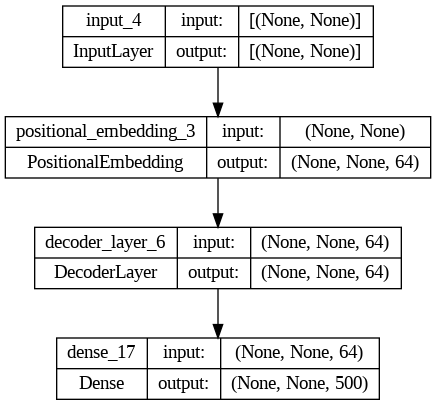

In [39]:
tf.keras.utils.plot_model(decoder_piano, show_shapes=True)

### Callbacks

In [40]:
# init callbacks
music_gen_callback = MusicGenerator(
    generate_len=200,
    test_dataset=test_piano,
    tokenizer=tokenizer_piano,
    temperatures=(0.2, 0.5, 0.7, 1., 1.5),
    print_freq=25
)

callbacks = [
    music_gen_callback,
    tf.keras.callbacks.EarlyStopping(
        monitor="val_loss",
        patience=5,
        verbose=0
    ),
]

### Train the model

In [41]:
epochs = 100

history = decoder_piano.fit(
    train_piano,
    epochs=epochs,
    validation_data=val_piano,
    use_multiprocessing=True,
    callbacks=callbacks
)

Epoch 1/100
157/157 [==============================] - 21s 101ms/step - loss: 4.3560 - val_loss: 3.9571
Epoch 2/100
157/157 [==============================] - 10s 64ms/step - loss: 3.7677 - val_loss: 3.5842
Epoch 3/100
157/157 [==============================] - 10s 64ms/step - loss: 3.4917 - val_loss: 3.4480
Epoch 4/100
157/157 [==============================] - 10s 66ms/step - loss: 3.3843 - val_loss: 3.3839
Epoch 5/100
157/157 [==============================] - 9s 56ms/step - loss: 3.3250 - val_loss: 3.3376
Epoch 6/100
157/157 [==============================] - 9s 60ms/step - loss: 3.2839 - val_loss: 3.3059
Epoch 7/100
157/157 [==============================] - 11s 67ms/step - loss: 3.2543 - val_loss: 3.2812
Epoch 8/100
157/157 [==============================] - 11s 69ms/step - loss: 3.2299 - val_loss: 3.2638
Epoch 9/100
157/157 [==============================] - 10s 61ms/step - loss: 3.2093 - val_loss: 3.2516
Epoch 10/100
157/157 [==============================] - 10s 61ms/step - lo

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_25_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_25_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_25_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_25_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_25_15.mid
157/157 [==============================] - 81s 518ms/step - loss: 3.0998 - val_loss: 3.1872
Epoch 26/100
157/157 [==============================] - 11s 68ms/step - loss: 3.0975 - val_loss: 3.1860
Epoch 27/100
157/157 [==============================] - 10s 66ms/step - loss: 3.0938 - val_loss: 3.1849
Epoch 28/100
157/157 [==============================] - 9s 55ms/step - loss: 3.0917 - val_loss: 3.1841
Epoch 29/100
157/157 [==============================] - 10s 66ms/step - loss: 3.0895 - val_loss: 3.1839
Epoch 30/100
157/157 [==============================] - 11s 73ms/step - loss: 3.0875 - val_loss: 3.1832
Epoch 31/100
157/157 [==============================] - 9s 57ms/step - loss: 3.0857 - val_loss: 3.1823
Epoch 32/100
157/157 [==============================] - 10s 66ms/step - loss: 3.0838 - val_loss: 3.1804
Epoch 33/100
157/157 [==============================] - 10s 64ms/step - loss: 3.0815 - val_loss: 3.1791
Epoch 34/100
157/157 [=======

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_50_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_50_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_50_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_50_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_50_15.mid
157/157 [==============================] - 70s 450ms/step - loss: 3.0576 - val_loss: 3.1672
Epoch 51/100
157/157 [==============================] - 9s 54ms/step - loss: 3.0560 - val_loss: 3.1649
Epoch 52/100
157/157 [==============================] - 11s 68ms/step - loss: 3.0552 - val_loss: 3.1651
Epoch 53/100
157/157 [==============================] - 10s 65ms/step - loss: 3.0545 - val_loss: 3.1645
Epoch 54/100
157/157 [==============================] - 10s 61ms/step - loss: 3.0534 - val_loss: 3.1634
Epoch 55/100
157/157 [==============================] - 10s 62ms/step - loss: 3.0521 - val_loss: 3.1621
Epoch 56/100
157/157 [==============================] - 11s 68ms/step - loss: 3.0512 - val_loss: 3.1630
Epoch 57/100
157/157 [==============================] - 10s 62ms/step - loss: 3.0507 - val_loss: 3.1609
Epoch 58/100
157/157 [==============================] - 10s 62ms/step - loss: 3.0499 - val_loss: 3.1611
Epoch 59/100
157/157 [======

  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_75_2.mid

Generating MIDI with temperature of 0.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_75_5.mid

Generating MIDI with temperature of 0.7...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_75_7.mid

Generating MIDI with temperature of 1.0...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_75_10.mid

Generating MIDI with temperature of 1.5...


  0%|          | 0/200 [00:00<?, ?it/s]

MIDI generated: generated_midis/output_75_15.mid
157/157 [==============================] - 69s 445ms/step - loss: 3.0390 - val_loss: 3.1558
Epoch 76/100
157/157 [==============================] - 10s 65ms/step - loss: 3.0385 - val_loss: 3.1533
Epoch 77/100
157/157 [==============================] - 11s 68ms/step - loss: 3.0376 - val_loss: 3.1541
Epoch 78/100
157/157 [==============================] - 11s 68ms/step - loss: 3.0372 - val_loss: 3.1531
Epoch 79/100
157/157 [==============================] - 11s 69ms/step - loss: 3.0364 - val_loss: 3.1539
Epoch 80/100
157/157 [==============================] - 8s 53ms/step - loss: 3.0363 - val_loss: 3.1547
Epoch 81/100
157/157 [==============================] - 9s 57ms/step - loss: 3.0350 - val_loss: 3.1533
Epoch 82/100
157/157 [==============================] - 10s 65ms/step - loss: 3.0352 - val_loss: 3.1544
Epoch 83/100
157/157 [==============================] - 11s 69ms/step - loss: 3.0348 - val_loss: 3.1536


Plot the loss of the training against the validation loss.

val_loss [3.9571030139923096, 3.5842485427856445, 3.448009729385376, 3.3839056491851807, 3.3376049995422363, 3.305919647216797, 3.2812130451202393, 3.2638442516326904, 3.2516369819641113, 3.240041732788086, 3.231311559677124, 3.2242562770843506, 3.218808650970459, 3.212106704711914, 3.2094919681549072, 3.2061941623687744, 3.2019050121307373, 3.199714422225952, 3.1992504596710205, 3.194897413253784, 3.19317364692688, 3.190728187561035, 3.1892545223236084, 3.187793731689453, 3.1872434616088867, 3.1859641075134277, 3.184903860092163, 3.184056043624878, 3.1838629245758057, 3.1831881999969482, 3.182274341583252, 3.1803956031799316, 3.179112195968628, 3.179318904876709, 3.175568103790283, 3.1753013134002686, 3.1748220920562744, 3.1735379695892334, 3.1712839603424072, 3.171966552734375, 3.1724071502685547, 3.1704156398773193, 3.1711437702178955, 3.1702356338500977, 3.1688930988311768, 3.168614387512207, 3.1679766178131104, 3.168509006500244, 3.168330192565918, 3.1671717166900635, 3.1649370193

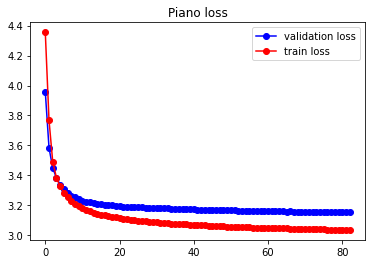

In [42]:
# plot the loss
plot_loss(history, title="Piano loss")

We take the best epoch and we re-train the model

Save the model

In [46]:
decoder_piano.save("saved_model/decoder_piano.h5")

In [47]:
!cp -R -v saved_model/decoder_piano.h5 '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model'

'saved_model/decoder_piano.h5' -> '/content/drive/My Drive/__Baldi_Cecchetti/models/Transformer/saved_model/decoder_piano.h5'


load the model

In [48]:
# we need to specify the custom layers
loaded_decoder = tf.keras.models.load_model(
    "saved_model/decoder_piano.h5",
    custom_objects={
        "PositionalEmbedding": PositionalEmbedding,
        "DecoderLayer": DecoderLayer,
        }
)

In [49]:
loaded_decoder.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, None)]       0           []                               
                                                                                                  
 positional_embedding_3 (Positi  (None, None, 64)    64000       ['input_4[0][0]']                
 onalEmbedding)                                                                                   
                                                                                                  
 decoder_layer_6 (DecoderLayer)  (None, None, 64)    216000      ['positional_embedding_3[0][0]', 
                                                                  'positional_embedding_3[0][0]'] 
                                                                                            

## Evaluation

In [50]:
# evaluate
losses = loaded_decoder.evaluate(test_piano, return_dict=True)
losses

44/44 [==============================] - 5s 107ms/step - loss: 3.1566


{'loss': 3.1566343307495117}

## Music generation

In [51]:
temperatures= (0.2, 0.5, 0.7, 1., 1.5)

for index, temperature in enumerate(temperatures):
    print(f"temperature: {temperature}")
    generate_music(loaded_decoder, test_piano, tokenizer_piano, temperature, path=f"piano{index}.mid", max_length=500)

temperature: 0.2

Generating MIDI with temperature of 0.2...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: piano0.mid
temperature: 0.5

Generating MIDI with temperature of 0.5...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: piano1.mid
temperature: 0.7

Generating MIDI with temperature of 0.7...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: piano2.mid
temperature: 1.0

Generating MIDI with temperature of 1.0...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: piano3.mid
temperature: 1.5

Generating MIDI with temperature of 1.5...


  0%|          | 0/500 [00:00<?, ?it/s]

MIDI generated: piano4.mid


In [52]:
# temperature 0.2
display_audio("piano0.mid")

In [53]:
# temperature 0.5
display_audio("piano1.mid")

In [54]:
# temperature 0.7
display_audio("piano2.mid")

In [55]:
# temperature 1
display_audio("piano3.mid")

In [56]:
# temperature 1.5
display_audio("piano4.mid")